# <font size=7>Real Estate Development/Investing Analysis</font>

<font size=4>Topics:</font>
1. Data analysis without geospatial tools
2. Geospatial integration to the analysis
   - Dynamic Maps + Widgets
   - SQL utilities
   - Carto Routing for shopping dominance areas
3. Regression algorithm for house price prediction
   - Carto Isochrones for POIs availability
   - Carto Data Catalog

## <font size=6>1. Load libraries</font>

In [1]:
from cartoframes.data.services import Isolines
from cartoframes import viz, read_carto, to_carto
from cartoframes.auth import set_default_credentials
set_default_credentials('creds.json')

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt 
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.ticker import FuncFormatter
import seaborn as sns
sns.set_style('whitegrid')

from shapely.geometry import Point
import geopandas as gpd

from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.tree import DecisionTreeRegressor

import time
import datetime
import os
import warnings
warnings.filterwarnings('ignore')

## <font size=6>2. Data prep</font>

In [ ]:
neighbourhoods = gpd.read_file('data/vector/Neighborhoods.geojson')
homes = gpd.read_file('data/vector/la_homes.geojson')

In [ ]:
neighbourhoods.head(3)

In [ ]:
homes.head(3)

In [ ]:
print('Counties cols:')
print(neighbourhoods.columns)
print('\nLA homes cols:')
print(homes.columns)

In [ ]:
cols = [
    'cartodb_id', 'date', 'saleprice', 'bedrooms', 'bathrooms',
    'effective_yearbuilt', 'generalusetype', 'specificusetype', 'sqftmain', 
    'price_sqft', 'city', 'homes', 'centroid'
]
numcols = ['saleprice', 'sqftmain', 'bedrooms', 'bathrooms']

homes['centroid'] = homes['geometry'].to_crs('EPSG:3857').centroid.to_crs(homes.crs)
homes['price_sqft'] = homes.saleprice/homes.sqftmain

homes = (
    homes.set_geometry('centroid')
    .rename(columns={
        'geometry': 'homes',
        'formatted_saledate': 'date'
    })
    .loc[:, cols]
    .dropna()
)

for col in numcols:
    _min, _max = np.percentile(homes[col], [5, 95])
    homes = homes[homes[col].between(_min, _max)]

In [ ]:
ax = neighbourhoods.boundary.plot(color='gray', linewidth=.4, figsize=(10,10))
homes.plot(markersize=.2, alpha=.1, color='r', ax=ax)
plt.axis('off');

In [ ]:
# select only homes from LA
tstart = time.time()
assert homes.crs == neighbourhoods.crs, "gdfs must have same CRS."
la_homes = gpd.sjoin(homes, neighbourhoods).drop(columns=['index_right']).rename(columns={'name': 'neighbourhood'})
print(f'Spatial join took {round(time.time() - tstart, 2)} secs.')
print(len(la_homes), 'home sales in LA.')

In [ ]:
ax = neighbourhoods.boundary.plot(color='gray', linewidth=.4, figsize=(10,10))
la_homes.plot(markersize=.4, alpha=.1, color='r', ax=ax)
plt.axis('off');

In [ ]:
la_homes.drop(columns=['homes']).to_file('data/vector/la_homes_clean.geojson', driver='GeoJSON')

## <font size=6>3. Data analysis</font>

In [2]:
la_homes = gpd.read_file('data/vector/la_homes_clean.geojson');

la_homes['effective_yearbuilt'] = la_homes.effective_yearbuilt.astype(int);
la_homes['date'] = pd.to_datetime(la_homes['date'])
la_homes = la_homes.sort_values('date')

la_homes.head()

,cartodb_id,date,saleprice,bedrooms,bathrooms,effective_yearbuilt,generalusetype,specificusetype,sqftmain,price_sqft,city,neighbourhood,geometry
11149,3830,2017-07-31,2200022,2.0,3.0,2002,Residential,Single Family Residence,2098,1048.628217,SANTA MONICA CA,Santa Monica,POINT (-118.49603 34.03089)
77683,107087,2017-07-31,1050010,2.0,2.0,2017,Residential,Single Family Residence,864,1215.289352,LOS ANGELES CA,Silver Lake,POINT (-118.26939 34.08349)
80937,95684,2017-07-31,990009,3.0,2.0,1975,Residential,Single Family Residence,1748,566.366705,SIERRA MADRE CA,Sierra Madre,POINT (-118.06363 34.16984)
74118,70570,2017-07-31,431004,4.0,2.0,1961,Residential,Single Family Residence,1595,270.221944,LOS ANGELES CA,Pacoima,POINT (-118.41747 34.25798)
19207,77747,2017-07-31,650006,4.0,2.0,1966,Residential,Single Family Residence,1792,362.726562,LAKEWOOD CA,Lakewood,POINT (-118.12075 33.85027)


Ok, so we have information 84k sells over the past 3 years and we know for each operation, the **date**, **price**, **house square footage**, **number of bedrooms and bathrooms**, **year of construction** and **type of use**.

Let's start by asking:

<font size=4> What type of house are currently beeing sold in LA?</font>

In [3]:
print('Properties general use type sells:')
la_homes.generalusetype.value_counts()

Properties general use type sells:


Residential      83763
Commercial         152
(missing)           68
Institutional       11
Industrial           7
Miscellaneous        2
Dry Farm             1
Name: generalusetype, dtype: int64

In [4]:
print('Properties specific use type sells:')
print(la_homes.specificusetype.value_counts().head(10))
print('')

Properties specific use type sells:
Single Family Residence                               78577
Double, Duplex, or Two Units                           3488
Three Units (Any Combination)                          1021
Four Units  (Any Combination)                           521
Five or More Units or Apartments (Any Combination)      132
Store Combination                                        97
(missing)                                                68
Office Building                                          23
Manufactured Home                                        21
Hotel and Motel                                          13
Name: specificusetype, dtype: int64



<font size=4>Price / Size relation</font>

NumExpr defaulting to 4 threads.


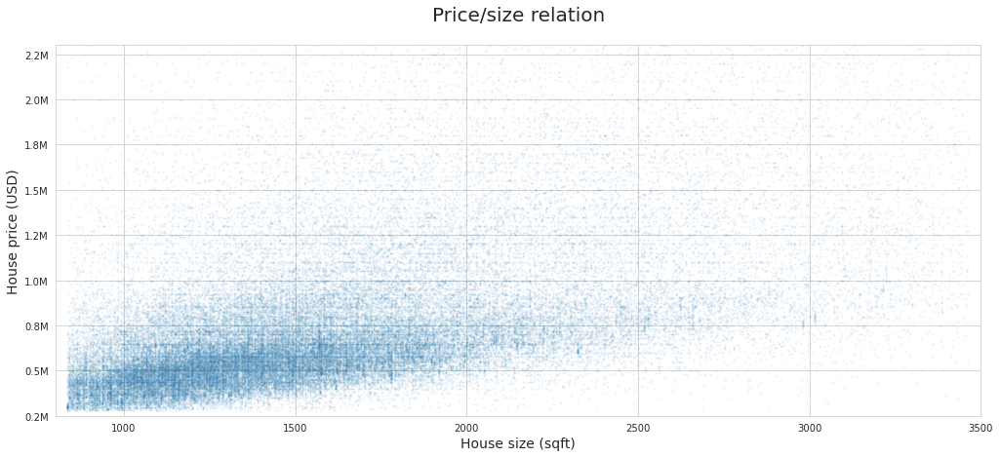

In [5]:
fig, ax = plt.subplots(figsize=(17, 7))
sns.scatterplot(data=la_homes, x='sqftmain', y='saleprice', alpha=0.1, s=4, ax=ax)
ax.set_title('Price/size relation', y=1.05, fontdict={'fontsize': 20});
ax.set_xlabel('House size (sqft)', fontdict={'fontsize': 14})
ax.set_ylabel('House price (USD)', fontdict={'fontsize': 14})
ax.set_xlim(800,3500)
ax.set_ylim(0.25e6, 2.3e6)
formatter = FuncFormatter(lambda x, pos: '%1.1fM' % (x * 1e-6))
ax.yaxis.set_major_formatter(formatter)

<font size=4>What is the distribution of prices in LA?</font>

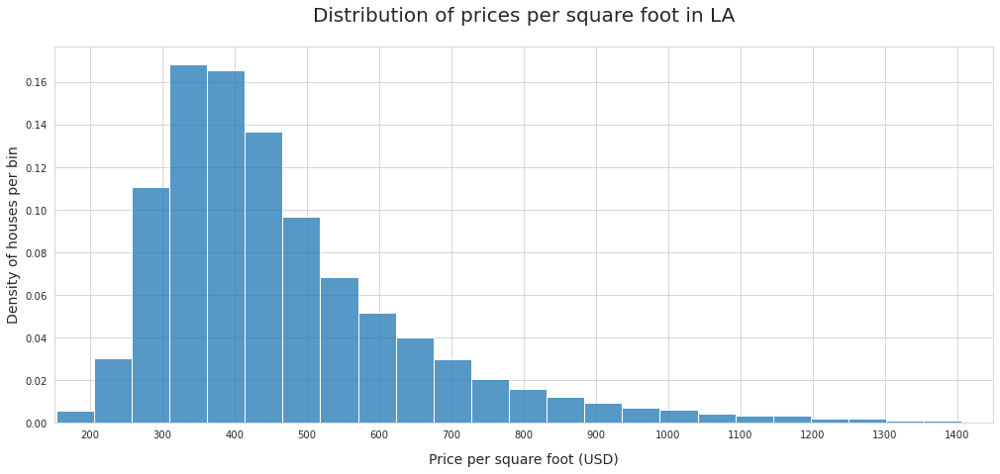

In [6]:
fig, ax = plt.subplots(figsize=(17, 7))

sns.histplot(data=la_homes, x="price_sqft", stat="probability", bins=50, ax=ax);
ax.set_xlim(150, 1450);
ax.set_xticks(range(200, 1500, 100));

ax.set_title('Distribution of prices per square foot in LA', y=1.05, fontdict={'fontsize': 20});
ax.set_ylabel('Density of houses per bin', fontdict={'fontsize': 14})
ax.set_xlabel('Price per square foot (USD)', fontdict={'fontsize': 14})
ax.xaxis.set_label_coords(0.5,-.08)

It seems that most houses cost betwenn 300 and 500 USD per squared feet although there are some cheaper houses and a skew to the right with more expensive options.

Let's check what the most expensive and cheaper neighbourhoods are.

In [7]:
price_per_neighbourhood = la_homes.groupby('neighbourhood')['price_sqft'].mean().sort_values(ascending=False).to_frame().round(0).astype(int)
top10 = price_per_neighbourhood.head(10).copy()
bottom10 = price_per_neighbourhood.tail(10).copy()

print('Top 10 most expensive neighbourhoods:')
print(top10)

print('\nTop 10 cheapest neighbourhoods:')
print(bottom10)
print('')

Top 10 most expensive neighbourhoods:
                   price_sqft
neighbourhood                
Manhattan Beach          1098
Venice                   1068
Santa Monica              964
Hermosa Beach             932
Cheviot Hills             928
Mar Vista                 913
Fairfax                   911
Pacific Palisades         910
Beverly Grove             888
Beverlywood               883

Top 10 cheapest neighbourhoods:
                        price_sqft
neighbourhood                     
Paramount                      324
Chatsworth Reservoir           319
Historic South-Central         315
Florence-Firestone             314
Pomona                         309
Irwindale                      309
Huntington Park                306
Watts                          298
Central-Alameda                296
South Park                     291



Let's compare the distribution of price between these groups of neighbourhoods.

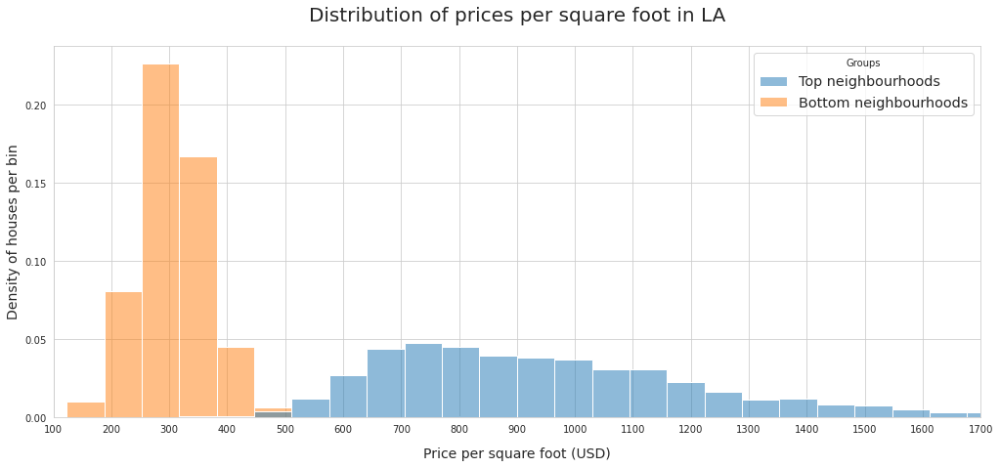

In [8]:
top10_homes = la_homes.loc[la_homes.neighbourhood.isin(top10.index), 'price_sqft'].to_frame().copy()
top10_homes['group'] = 'top'

bottom10_homes = la_homes.loc[la_homes.neighbourhood.isin(bottom10.index), 'price_sqft'].to_frame().copy()
bottom10_homes['group'] = 'bottom'

fig, ax = plt.subplots(figsize=(17, 7))

sns.histplot(
    data=pd.concat([top10_homes, bottom10_homes]), 
    x='price_sqft', 
    stat='probability', 
    hue='group',
    bins=40,
    ax=ax)

ax.set_xlim(150, 1450);
ax.set_xticks(range(100, 1800, 100));
ax.set_title('Distribution of prices per square foot in LA', y=1.05, fontdict={'fontsize': 20});
ax.set_ylabel('Density of houses per bin', fontdict={'fontsize': 14})
ax.set_xlabel('Price per square foot (USD)', fontdict={'fontsize': 14})
ax.xaxis.set_label_coords(0.5,-.08)

legend = ax.get_legend()
handles = legend.legendHandles
legend.remove()
ax.legend(handles, ['Top neighbourhoods', 'Bottom neighbourhoods'], title='Groups', fontsize='x-large')
plt.show()

Interesting, aparently cheaper neighbourhoods are actually cheap, but the most expensive neighbourhoods actually have a wider distribution of prices. This means we will need to look at more granular data to find out what areas are the most expensive ones and why! 

Before we get into that, lets check if price per sqft varies according to the season.

<font size=4>IS there any seasonlaity?</font>

In [9]:
window = 7
roll = (
    la_homes.groupby(pd.Grouper(key='date', freq='1W')).agg({
        'cartodb_id': 'count',
        'price_sqft': 'mean'
    }).rename(columns={
        'cartodb_id': 'n_sales',
        'price_sqft': 'mean_price_sqft'
    }).rolling(window).mean().round(1)
    .iloc[:-3]
)

roll.tail()

,n_sales,mean_price_sqft
date,,
2019-05-05,980.4,485.4
2019-05-12,983.9,487.2
2019-05-19,973.3,487.9
2019-05-26,870.3,488.8
2019-06-02,747.1,491.1


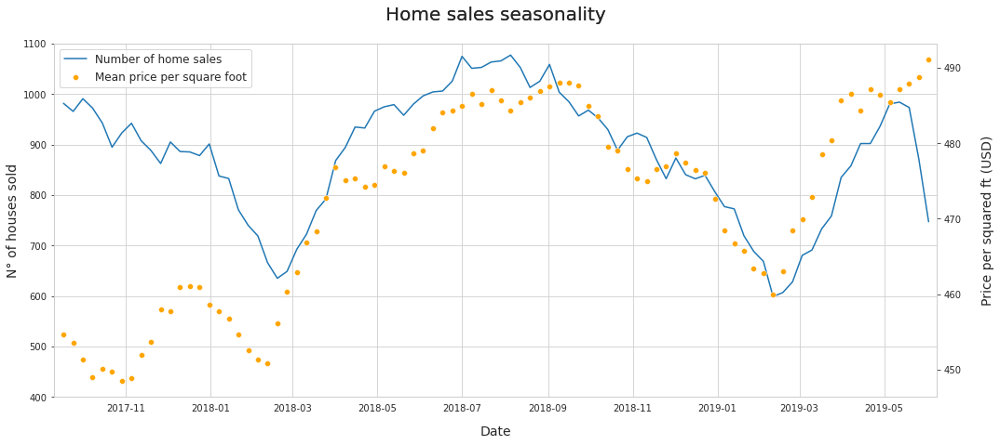

In [10]:
fig, ax = plt.subplots(figsize=(17, 7))

sns.lineplot(data=roll.reset_index(), x="date", y="n_sales", ax=ax, label='Number of home sales', legend=None)
ax.set_xlim([roll.index[5], roll.index.max() + pd.Timedelta(6, 'day')]);
ax.set_ylim(400, 1100)
ax.set_title('Home sales seasonality', y=1.05, fontdict={'fontsize': 20});
ax.set_ylabel('N° of houses sold', fontdict={'fontsize': 14})
ax.set_xlabel('Date', fontdict={'fontsize': 14})
ax.xaxis.set_label_coords(0.5,-.08)


ax2 = ax.twinx()
sns.scatterplot(data=roll.reset_index(), x="date", y="mean_price_sqft", ax=ax2, label='Mean price per square foot', color='orange', legend=None)
ax2.grid(False)
ax2.set_title('Home sales seasonality', y=1.05, fontdict={'fontsize': 20});
ax2.set_ylabel('Price per squared ft (USD)', fontdict={'fontsize': 14})
ax2.set_xlabel('Date', fontdict={'fontsize': 14})
ax2.yaxis.set_label_coords(1.05, 0.5)

lines, labels = ax.get_legend_handles_labels()
lines2, labels2 = ax2.get_legend_handles_labels()
ax2.legend(lines + lines2, labels + labels2, loc=0, fontsize='large');

It looks like house demand increases on summer and decreases on winter. Apparently, the hous demand has a relation with the house price per sqeare foot. Makes sense, the greater the demand, the higher the price.

## <font size=6>4. Geospatial analysis</font>

### Carto Dynamic Maps 

In [11]:
neighbourhoods = gpd.read_file('data/vector/Neighborhoods.geojson')

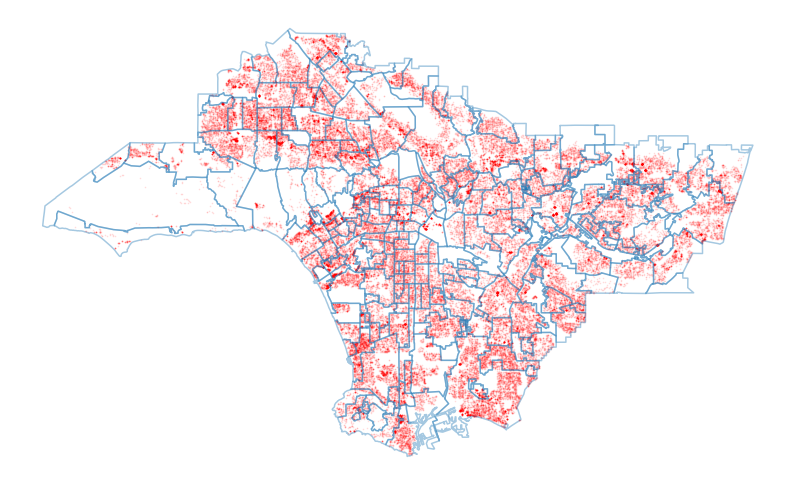

In [12]:
ax = neighbourhoods.boundary.plot(figsize=(14,14), alpha=.4)
la_homes.plot(ax=ax, markersize=.5, alpha=.1, color='r')
ax.grid(False)
ax.axis('off');

In [13]:
viz.Map(
    layers= [
        viz.Layer(
            source=la_homes,
            style=viz.color_bins_style('price_sqft', palette='Temps'),
            widgets=viz.histogram_widget('price_sqft', title='diff histogram', buckets=9)
        ),
        viz.Layer(
            source=neighbourhoods,
            style=viz.basic_style(stroke_color='black', opacity=0, stroke_width=1),
            popup_click=viz.popup_element('name', title='Neighbourhood:')
        )
    ]
)

### Carto SQL functionality & Dynamic Maps

In [14]:
xmin, ymin, xmax, ymax = neighbourhoods.unary_union.bounds
sql = f"""
Select ST_Transform(CDB_HexagonGrid(ST_Transform(ST_MakeEnvelope({xmin}, {ymin}, {xmax}, {ymax}, 4326), 3857), 700), 4326) as the_geom
"""
grid = read_carto(sql)
print('Grid created successfully.')

assert neighbourhoods.crs == grid.crs, "gdfs must have same CRS."

clipped_grid = (
    gpd.sjoin(grid, neighbourhoods)
        .drop_duplicates('the_geom')
        .geometry.to_frame()
        .reset_index(drop=True)
        .rename(columns={'the_geom': 'geometry'})
        .set_geometry('geometry')
)

numcols = ['saleprice', 'sqftmain', 'price_sqft']

stime = time.time()

stats_per_hex = (
    gpd.sjoin( 
        clipped_grid,
        la_homes[numcols + ['geometry']],
        how='inner',
        op='intersects'
    )
    .reset_index()
    .groupby('index').agg(
        tot_sales=pd.NamedAgg(column='saleprice', aggfunc='sum'),
        sqftmain=pd.NamedAgg(column='sqftmain', aggfunc='mean'),
        price_sqft=pd.NamedAgg(column='price_sqft', aggfunc='mean'),
        n_sales=pd.NamedAgg(column='price_sqft', aggfunc='count'),
        geometry=pd.NamedAgg(column='geometry', aggfunc=lambda g: g.iloc[0]),
    )
    .set_geometry('geometry')
    .round()
    
)

print(f'Stats for {len(la_homes)} homes and {len(clipped_grid)} hexagons calculated in {round(time.time() - stime, 2)} secs.')
stats_per_hex.head()

Grid created successfully.
Stats for 84004 homes and 4541 hexagons calculated in 0.56 secs.


,tot_sales,sqftmain,price_sqft,n_sales,geometry
index,,,,,
27,1200012,1385.0,866.0,1,"POLYGON ((-118.88799 34.06409, -118.89113 34.0..."
28,1870017,1518.0,619.0,2,"POLYGON ((-118.88799 34.07311, -118.89113 34.0..."
49,7995078,1936.0,1084.0,4,"POLYGON ((-118.85969 34.04153, -118.86283 34.0..."
59,2300023,3129.0,735.0,1,"POLYGON ((-118.85026 34.04604, -118.85340 34.0..."
69,3209031,1994.0,813.0,2,"POLYGON ((-118.84082 34.04153, -118.84397 34.0..."


In [15]:
palette = '[#dc7176,#c8586c,#9c3f5d,#70284a,#ecda9a,#efc47e,#f3ad6a]'

viz.Layout(
    [
        viz.Map( # price_sqft
            layers=[
                viz.Layer(
                    source=stats_per_hex, 
                    style=viz.color_bins_style('price_sqft', bins=7, opacity='.8', palette='reverse(sunset)', stroke_width=0), 
                    popup_click=viz.popup_element('price_sqft', title='Price per sqft:'),
                    encode_data=False
                ),
                viz.Layer(
                    source=neighbourhoods,
                    style=viz.basic_style(stroke_width=0.8, opacity=0, stroke_color='gray'),
                    popup_click=viz.popup_element('name', title='Neighbourhood:')
                )
            ],
           title="Mean price per square foot"
        ),
        viz.Map( # n_sales
            layers=[
                viz.Layer(
                    source=stats_per_hex, 
                    style=viz.color_bins_style('n_sales', bins=7, opacity='.8', palette='reverse(sunset)', stroke_width=0, method='quantiles'), 
                    encode_data=False
                ),
                viz.Layer(
                    source=neighbourhoods,
                    style=viz.basic_style(stroke_width=0.8, opacity=0, stroke_color='gray'),
                    popup_click=viz.popup_element('name', title='Neighbourhood:')
                )
            ],
           title="Number of sale operations"
        ),
                viz.Map( # price
            layers=[
                viz.Layer(
                    source=stats_per_hex, 
                    style=viz.color_bins_style('tot_sales', bins=5, opacity='.8', palette='reverse(sunset)', stroke_width=0, method='quantiles'), 
                    encode_data=False
                ),
                viz.Layer(
                    source=neighbourhoods,
                    style=viz.basic_style(stroke_width=0.8, opacity=0, stroke_color='gray'),
                    popup_click=viz.popup_element('name', title='Neighbourhood:')
                )
            ],
           title="Total sales (USD)"
        ),
        viz.Map( # size
            layers=[
                viz.Layer(
                    source=stats_per_hex, 
                    style=viz.color_bins_style('sqftmain', bins=7, opacity='.8', palette='reverse(sunset)', stroke_width=0, method='quantiles'), 
                    encode_data=False
                ),
                viz.Layer(
                    source=neighbourhoods,
                    style=viz.basic_style(stroke_width=0.8, opacity=0, stroke_color='gray'),
                    popup_click=viz.popup_element('name', title='Neighbourhood:')
                )
            ],
           title="House size"
        ),
    ],
    2, 2, map_height=500
)

### Travel time to closest shopping

<font size=3>POIs dataset preparation</font>

In [16]:
fns = {
    'busStops/StopServingLines1219.shp': 'busStop',
    'Banks.geojson': 'bank',
    'Unis.geojson': 'university',
    'Hospitals.geojson': 'hospital',
    'Metro_Stations.geojson': 'metro',
    'Public_Elementary_Schools.geojson': 'elementary_school',
    'Public_High_Schools.geojson': 'high_school',
    'Public_Middle_Schools.geojson': 'middle_school',
    'Shopping_Centers.geojson': 'shopping'
}

gdfs = []
for fn, _type in fns.items():
    gdf = gpd.read_file('data/vector/'+fn)
    gdf = gdf[['geometry']]
    gdf['type'] = _type
    gdfs.append(gdf)

POIs = pd.concat(gdfs)

In [17]:
print('Points of Interest count by type:')
print(POIs['type'].value_counts())
print('')

Points of Interest count by type:
busStop              13974
bank                  2430
elementary_school     1202
high_school            462
shopping               348
middle_school          271
university             217
hospital               165
metro                   95
Name: type, dtype: int64



<font size=4>Carto routing </font>

In [18]:
start = Point(-118.34241, 33.90896)
end = Point(-118.22668, 33.94664)
sql = f"""
SELECT duration, length, shape as the_geom 
FROM cdb_route_point_to_point('{start.wkt}'::geometry, '{end.wkt}'::geometry, 'car')
"""
route = read_carto(sql).rename(columns={'the_geom': 'geometry'}).set_geometry('geometry')
route['duration'] = round(route['duration']/60, 2).astype(str) + ' mins.'
route['length'] = round(route['length']/1000, 2).astype(str) + ' km'
route['start'] = [start]
route['end'] = [end]
route.head()

,duration,length,geometry,start,end
0,30.27 mins.,14.08 km,"LINESTRING (-118.34241 33.90917, -118.34173 33...",POINT (-118.34241 33.90896),POINT (-118.22668 33.94664)


In [19]:
viz.Map(
    layers=[
        viz.Layer(
            route, 
            style=viz.basic_style(color='black'),
            popup_hover=[
                viz.popup_element('length', title='Length:'),
                viz.popup_element('duration', title='Duration:'),
            ]
            
        ),
        viz.Layer(
            route.set_geometry('start'), 
            style=viz.basic_style(color='green', size=8)
        ),
        viz.Layer(
            route.set_geometry('end'), 
            style=viz.basic_style(color='red', size=8)
        ),
    ]
)

<font size=3>Distance matrix calculation</font>

In [20]:
xmin, ymin, xmax, ymax = neighbourhoods.unary_union.bounds
sql = f"""
Select ST_Transform(CDB_HexagonGrid(ST_Transform(ST_MakeEnvelope({xmin}, {ymin}, {xmax}, {ymax}, 4326), 3857), 1000), 4326) as the_geom
"""
dm_grid = read_carto(sql)
print('Grid created successfully.')

assert neighbourhoods.crs == dm_grid.crs, "gdfs must have same CRS."

dm_grid = (
    gpd.sjoin(dm_grid, neighbourhoods)
        .drop_duplicates('the_geom')
        .geometry.to_frame()
        .reset_index()
        .rename(columns={
            'index': 'gid',
            'the_geom': 'geometry'
        }).set_geometry('geometry')
)

cross = (
    dm_grid.to_crs('EPSG:3857')
        .rename(columns={
            'gid': 'from_id', 
            'geometry': 'startp'}
    ).join(
        dm_grid.to_crs('EPSG:3857')
            .rename(columns={
                'gid': 'to_id', 
                'geometry': 'endp'
            }),
        how='cross'
    ).set_geometry('startp')
)
#cross = cross[cross.from_id != cross.to_id]
cross['startp'] = cross.startp.centroid
cross['endp'] = cross.endp.centroid

print(f'{len(cross)} distances to compute.')
cross['length'] = round(cross.startp.distance(cross.endp),0)
cross = cross.drop(columns=['startp', 'endp'])
#cross.head()

shoppings = POIs[POIs['type']=='shopping'].copy()
shoppings = gpd.sjoin(shoppings, dm_grid.to_crs(shoppings.crs))[['gid']].reset_index().rename(columns={'index': 'shop_id'})
# shoppings.head()

dm = cross.merge(shoppings, left_on='from_id', right_on='gid').pivot(index='to_id', columns='shop_id', values='length')
dominance = dm.apply(lambda r: pd.Series(data=[r.idxmin(), r.min()], index=['shop_id', 'distance']), axis=1)
dominance = dm_grid.merge(dominance, left_on='gid', right_index=True).to_crs('EPSG:4326')
dominance.head()

Grid created successfully.
5139289 distances to compute.


,gid,geometry,shop_id,distance
0,25,"POLYGON ((-118.93245 34.03830, -118.93694 34.0...",60.0,10536.0
1,26,"POLYGON ((-118.93245 34.05120, -118.93694 34.0...",60.0,10817.0
2,27,"POLYGON ((-118.93245 34.06409, -118.93694 34.0...",60.0,11358.0
3,28,"POLYGON ((-118.93245 34.07697, -118.93694 34.0...",60.0,12124.0
4,75,"POLYGON ((-118.91898 34.04475, -118.92347 34.0...",60.0,9165.0


<font size=4>Census population aggregation</font> 

In [21]:
census = gpd.read_file('data/vector/2010_Census_Data_By_Block.geojson')
pop = gpd.sjoin(dm_grid, census[['POP_2010', 'geometry']]).groupby('gid').agg(
        tot_pop=pd.NamedAgg(column='POP_2010', aggfunc='sum'),
        geometry=pd.NamedAgg(column='geometry', aggfunc=lambda g: g.iloc[0])
    ).set_geometry('geometry')
pop.head()

,tot_pop,geometry
gid,,
25,4,"POLYGON ((-118.93245 34.03830, -118.93694 34.0..."
26,14,"POLYGON ((-118.93245 34.05120, -118.93694 34.0..."
27,6,"POLYGON ((-118.93245 34.06409, -118.93694 34.0..."
28,18,"POLYGON ((-118.93245 34.07697, -118.93694 34.0..."
75,42,"POLYGON ((-118.91898 34.04475, -118.92347 34.0..."


In [22]:
viz.Layout(
    maps =
    [
        viz.Map( # distance
            layers=[
                viz.Layer(
                    source=dominance, 
                    style=viz.color_bins_style('distance', bins=10, opacity='.8', palette='sunset', stroke_width=0, method='equal'), 
                    encode_data=False
                ),
                viz.Layer(
                    source=gpd.sjoin(POIs[POIs['type']=='shopping'], neighbourhoods),
                    style=viz.basic_style(color='black', size=2),
                )
            ],
           title="Distance to closest shopping center"
        ),
        viz.Map(
            layers=[
                viz.Layer(
                    source=pop,
                    style=viz.color_bins_style('tot_pop', palette='reverse(sunset)', bins=7),
                    encode_data=False
                )
            ],
            title='Mean population by hexagon'
        )

    ],
    n_size=2, m_size=1, map_height=500
)

In [23]:
viz.Map(
    layers=[
        viz.Layer(
            source=dominance.dissolve('shop_id').reset_index('shop_id').astype({'shop_id': 'str'}), 
            style=viz.color_category_style('shop_id',cat=[str(i) for i in dominance.shop_id.unique()], palette='pastel'),
            encode_data=False
        ),
        viz.Layer(
            source=gpd.sjoin(POIs[POIs['type']=='shopping'], neighbourhoods),
            style=viz.basic_style(color='black', size=2),
            legends=viz.basic_legend()
        )
    ],
   title="Area dominance by shopping center"
)

## <font size=6>5. House price prediction</font>

### Carto Isochrones

<font size=3>An isochrone map in geography and urban planning is a map that depicts the area accessible from a point within a certain time threshold. By calculating the area that we can cover in a given ammount of time, we could find out what POIs are in the proximity of each house.</font>

<font size=3>CARTO has an isochrone service that allows us to calculate the isochrone for each geometry in a GeoDataFrame. Let's see how it works.</font>

In [24]:
sample = la_homes.head()
isochrones_15, _ = Isolines().isochrones(sample, [15*60], mode='walk', quality=3)
isochrones_15.head()

Success! Isolines created correctly


,source_id,data_range,the_geom
0,3830,900,"MULTIPOLYGON (((-118.50755 34.03170, -118.5074..."
1,107087,900,"MULTIPOLYGON (((-118.27889 34.08113, -118.2788..."
2,95684,900,"MULTIPOLYGON (((-118.07359 34.16903, -118.0735..."
3,70570,900,"MULTIPOLYGON (((-118.42858 34.25829, -118.4285..."
4,77747,900,"MULTIPOLYGON (((-118.13127 33.84836, -118.1311..."


In [25]:
viz.Map(
    [
        viz.Layer(
            gpd.sjoin(POIs, neighbourhoods), 
            style=viz.color_category_style('type', size=3, opacity=.7),
            widgets=viz.category_widget('type', title='POI type', description='description', footer='footer', read_only=False, weight=3)
        ),
        viz.Layer(isochrones_15, style=viz.basic_style(opacity=.2, color='blue'), encode_data=False),
        viz.Layer(sample, style=viz.basic_style(color='red', size=8))
    
    ]
)

<font size=3>Because we are about to build 76k isochrones, we are going to do this in a separe batch .py programm. This programm will send 380 chunks of the original dataset so that we don't overload the server.</font>

<font size=3>This program will send each chunk to the carto server and return a geodf with the isochrones. Once we have the current geodf, we save it to disk and move forward to the next chunk.</font>

<font size=3>Now we can start making intersting local context spatial merges with each home's nearby area!</font>

In [26]:
iso = gpd.read_file('data/vector/isochrones/iso.geojson').rename(columns={'source_id': 'cartodb_id'}).drop_duplicates('cartodb_id') 
print(len(iso), 'isochrones')
iso.head()

76101 isochrones


,cartodb_id,data_range,geometry
0,120490,900,"MULTIPOLYGON (((-118.57209 34.29537, -118.5720..."
1,78293,900,"MULTIPOLYGON (((-118.11891 33.83463, -118.1186..."
2,94122,900,"MULTIPOLYGON (((-118.30499 34.26172, -118.3047..."
3,113316,900,"MULTIPOLYGON (((-118.49587 34.03719, -118.4957..."
4,71770,900,"MULTIPOLYGON (((-118.27821 34.16765, -118.2781..."


In [27]:
iso = (
    pd.merge(iso, la_homes, how='inner', on='cartodb_id')
    .rename(columns={
        'geometry_x': 'isochrone',
        'geometry_y': 'house'
    })
    .drop_duplicates('cartodb_id')
    .set_geometry('isochrone')
)
print(len(iso), 'total geometries.')
iso.head(2)

76101 total geometries.


,cartodb_id,data_range,isochrone,date,saleprice,bedrooms,bathrooms,effective_yearbuilt,generalusetype,specificusetype,sqftmain,price_sqft,city,neighbourhood,house
0,120490,900,"MULTIPOLYGON (((-118.57209 34.29537, -118.5720...",2017-10-25,690006,3.0,3.0,1987,Residential,Single Family Residence,1903,362.588544,LOS ANGELES CA,Porter Ranch,POINT (-118.56157 34.29189)
1,78293,900,"MULTIPOLYGON (((-118.11891 33.83463, -118.1186...",2017-10-25,475004,2.0,1.0,1958,Residential,Single Family Residence,1155,411.258874,LAKEWOOD CA,Lakewood,POINT (-118.10712 33.83345)


In [28]:
assert POIs.crs == iso.crs, "gdfs must be on the same CRS"

st = time.time()
sjoin = gpd.sjoin(POIs, iso, how='right', op='within').fillna({'type': 'cero'}).drop(columns=['index_left'])
print(f'Join between {len(POIs)} POIs and {len(iso)} isochrones done in {round(time.time()-st, 2)} secs.')



pivot = sjoin.pivot_table(index='cartodb_id', columns='type', values='saleprice', aggfunc='count', fill_value=0).reset_index().drop(columns=['cero'])

la_homes_enriched = pd.merge(
    sjoin.drop_duplicates('cartodb_id'),
    pivot,
    how='inner',
    on='cartodb_id'
)
la_homes_enriched[
    (la_homes_enriched.bank.ne(0)) &
    (la_homes_enriched.hospital.ne(0)) &
    (la_homes_enriched.metro.ne(0)) &
    (la_homes_enriched.busStop.ne(0)) 
].head()

Join between 19164 POIs and 76101 isochrones done in 4.4 secs.


,type,cartodb_id,data_range,isochrone,date,saleprice,bedrooms,bathrooms,effective_yearbuilt,generalusetype,...,house,bank,busStop,elementary_school,high_school,hospital,metro,middle_school,shopping,university
22,busStop,39148,900,"MULTIPOLYGON (((-118.54875 34.17933, -118.5484...",2017-10-25,290002,2.0,2.0,1978,Residential,...,POINT (-118.53682 34.17708),5,37,1,1,1,1,0,2,2
52,elementary_school,13489,900,"MULTIPOLYGON (((-118.20886 33.80922, -118.2087...",2017-10-25,545005,3.0,2.0,1941,Residential,...,POINT (-118.19621 33.80718),3,7,3,0,5,1,0,0,0
60,busStop,104049,900,"MULTIPOLYGON (((-118.15392 34.13813, -118.1536...",2017-10-26,800008,2.0,3.0,1983,Residential,...,POINT (-118.14056 34.13552),25,60,1,1,1,2,0,2,2
168,busStop,61831,900,"MULTIPOLYGON (((-118.31872 34.05710, -118.3186...",2017-10-26,570005,3.0,2.0,2006,Residential,...,POINT (-118.30622 34.05550),37,105,5,4,1,2,0,2,3
186,busStop,82243,900,"MULTIPOLYGON (((-118.29812 34.08388, -118.2978...",2017-10-26,1000010,3.0,3.0,1965,Residential,...,POINT (-118.28528 34.08094),1,65,3,0,1,1,1,0,4


<font size="4"> Carto dataset catalog</font>

<font size="2">Crime Risk - United States of America (Census Block Group): Relative risk of specific crime types for any geographic area. Crime by type.</font>

<font size="2">Geographic Insights - United States of America (Census Block Group, monthly):  Sales, transactions, average ticket size , number of accounts, etc. happening in a retail area on a specific period in time.</font>

![carto dataset map example](credit-card.png)

### Model trainging and price prediction

In [29]:
numeric = [
    'bedrooms', 'bathrooms', 'sqftmain', 'bank', 'busStop',
    'elementary_school', 'high_school', 'hospital', 'metro', 'middle_school', 
    'shopping', 'university'
]
categorical = ['city', 'neighbourhood']

X = pd.concat([la_homes_enriched[numeric], pd.get_dummies(la_homes_enriched[categorical])], axis=1)
y = la_homes_enriched['saleprice']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

model = DecisionTreeRegressor(max_leaf_nodes=7600,random_state=454)
model.fit(X_train,y_train)
pred_y = model.predict(X_test)
score = metrics.r2_score(y_test, pred_y)

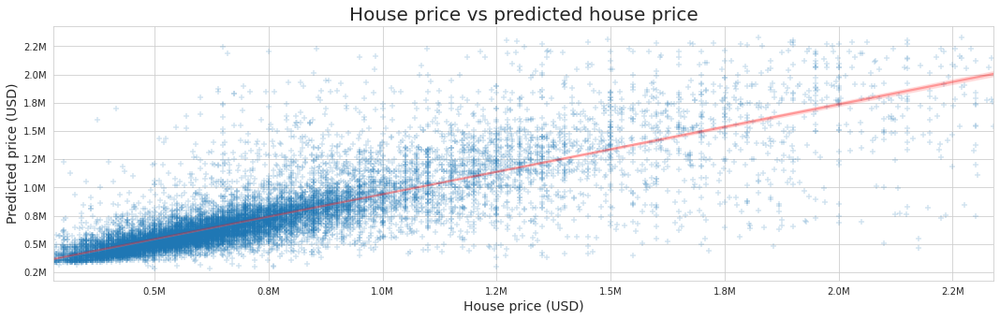

r2 score: 0.66


In [30]:

fig, ax = plt.subplots(figsize=(18,5))
sns.regplot(
    x=y_test, y=pred_y, ax=ax,  marker="+",
    line_kws={"color": "red", "alpha":0.3},
    scatter_kws={"alpha": .2}
)
ax.set_title('House price vs predicted house price', fontdict={'fontsize': 20})
ax.set_ylabel('Predicted price (USD)', fontdict={'fontsize': 14})
ax.set_xlabel('House price (USD)', fontdict={'fontsize': 14})


formatter = FuncFormatter(lambda x, pos: '%1.1fM' % (x * 1e-6))
ax.yaxis.set_major_formatter(formatter)
ax.xaxis.set_major_formatter(formatter)
plt.show()
print('r2 score:', round(score,2))

In [31]:

predicted = la_homes_enriched.loc[y_test.index]
predicted['predicted'] = [int(round(i, 0)) for i in pred_y]
predicted['diff'] = round(predicted.predicted/predicted.saleprice, 2)

#la_homes_poly = gpd.read_file('data/vector/la_homes.geojson')
#predicted_poly = predicted[['cartodb_id', 'diff']].merge(la_homes_poly[['cartodb_id', 'geometry']], on='cartodb_id').set_geometry('geometry')
#predicted_poly.head()

In [32]:

viz.Map(
    viz.Layer(
        source=predicted.set_geometry('house'),
        style=viz.color_bins_style('diff', palette='Temps'),
        widgets=viz.histogram_widget('diff', title='diff histogram', buckets=9)
        )
)

##  <font size=6>6. Recap</font>

<font size=4>1. House price factors in LA:</font>
>- <font size=3>House **location** (Geospatial distribution of high and low price per sqft)</font>
>- <font size=3>Season</font>
>- <font size=3>High value vs high volatility markets</font>


<font size=4>2. House price prediction algorithm</font>

<font size=4>3. CARTO's solutions used for analysis</font>
 >- <font size=3>Dynamic Maps + Widgets</font>
 >- <font size=3>SQL utilities (Hex Grid for granularity)</font>
 >- <font size=3>Carto Routing</font>
 >- <font size=3>Carto Isochrones</font>
 >- <font size=3>Carto Data Catalog</font>


## Extras

<font size=4>What can we tell from the house year of construction?</font>

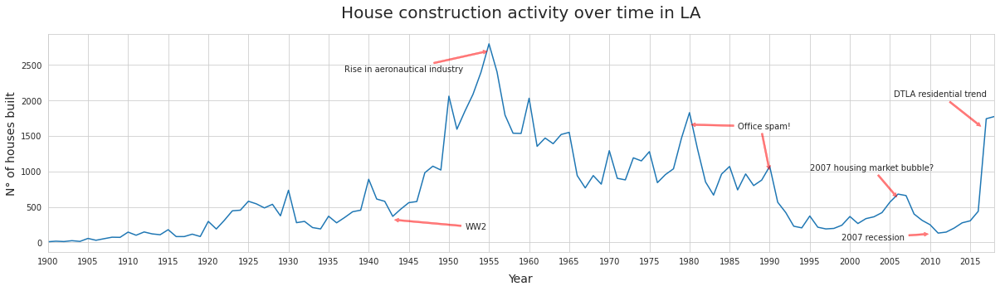

Source: www.commercialcafe.com/blog/history-los-angeles-real-estate-development/



In [33]:
constructions = (
    la_homes['effective_yearbuilt'].value_counts()
        .reset_index()
        .rename(columns={
            'index': 'year', 
            'effective_yearbuilt': 'n_buildings'}
        ).sort_values('year')
)

fig, ax1 = plt.subplots(figsize=(17, 5))
sns.lineplot(data=constructions[constructions.year.between(1900, 2018)], x='year', y='n_buildings', ax=ax1,);

ax1.set_title('House construction activity over time in LA', y=1.05, fontdict={'fontsize': 20});
ax1.set_ylabel('N° of houses built', fontdict={'fontsize': 14})
ax1.set_xlabel('Year', fontdict={'fontsize': 14})
ax1.xaxis.set_label_coords(0.5,-.1)
ax1.set_xticks(range(1900, 2021, 5))
ax1.set_xlim(1900,2018)

# Annotations
def add_annotation(ax, text, scoords, ecoords):
    ax1.annotate(text, xy=ecoords, xycoords='data', xytext=scoords, textcoords='data', arrowprops=dict(
        arrowstyle= 'simple',color='red', alpha=0.5, lw=.5, ls='-'))
    
add_annotation(ax1, 'Rise in aeronautical industry', (1937, 2400), (1955, 2700))
add_annotation(ax1, 'WW2', (1952, 180), (1943, 320))
add_annotation(ax1, 'Office spam!', (1986, 1600), (1980, 1660))
add_annotation(ax1, '', (1989, 1560), (1990, 1000))
add_annotation(ax1, 'DTLA residential trend', (2005.5,2050), (2016.5,1620))
add_annotation(ax1, '2007 housing market bubble?', (1995,1020), (2006,620))
add_annotation(ax1, '2007 recession', (1999, 30), (2010,120))


fig.subplots_adjust(hspace=-0.3)
plt.tight_layout()
plt.show()
print('Source: www.commercialcafe.com/blog/history-los-angeles-real-estate-development/\n')

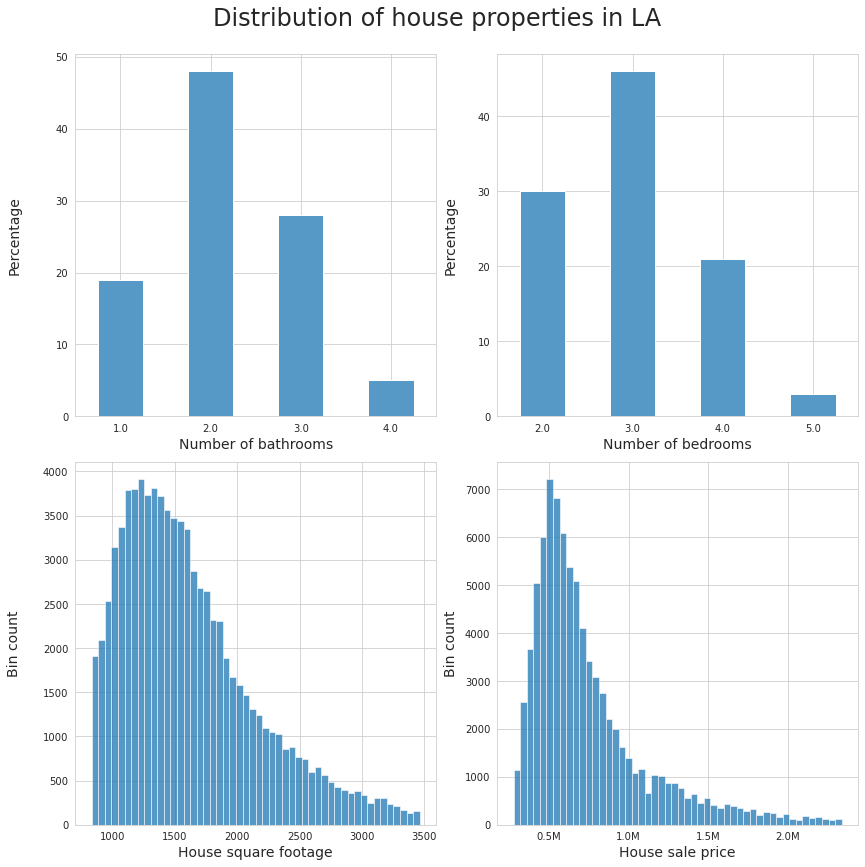

In [34]:
fig, ((ax1, ax2), (ax3, ax4)) = plt.subplots(nrows=2, ncols=2, figsize=(12,12))

#ax1 
(la_homes.bathrooms.value_counts(normalize=True, sort=False)*100).round().to_frame().sort_index().plot.bar(ax=ax1, legend=None, color='#5799C6')
ax1.set_xlabel('Number of bathrooms', fontdict={'fontsize': 14})
ax1.set_ylabel('Percentage', fontdict={'fontsize': 14})
ax1.tick_params(labelrotation=0)
ax1.yaxis.set_label_coords(-.15, .5)

#ax2
(la_homes.bedrooms.value_counts(normalize=True, sort=False)*100).round().to_frame().sort_index().plot.bar(ax=ax2, legend=None, color='#5799C6')
ax2.set_xlabel('Number of bedrooms', fontdict={'fontsize': 14})
ax2.set_ylabel('Percentage', fontdict={'fontsize': 14})
ax2.tick_params(labelrotation=0)
ax2.yaxis.set_label_coords(-.11, .5)

#ax3
sns.histplot(data=la_homes, x='sqftmain', bins=50, ax=ax3, stat='count')
ax3.set_xlabel('House square footage', fontdict={'fontsize': 14})
ax3.set_ylabel('Bin count', fontdict={'fontsize': 14})
ax3.yaxis.set_label_coords(-.15, .5)


#ax4
sns.histplot(data=la_homes, x='saleprice', bins=50, ax=ax4, stat='count');
ax4.set_xlabel('House sale price', fontdict={'fontsize': 14})
ax4.set_ylabel('Bin count', fontdict={'fontsize': 14})
ax4.yaxis.set_label_coords(-.11, .5)
ax4.set_xticklabels([str(i/1e6)+'M' for i in ax4.get_xticks()]);

fig.suptitle("Distribution of house properties in LA", fontsize=24, y=1)
plt.tight_layout()